In [56]:
import pandas as pd
import numpy as np
from gensim.models import Word2Vec, word2vec
import gensim.downloader as corpapi
import matplotlib.pyplot as plt
%matplotlib inline
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from sklearn.manifold import TSNE
import seaborn as sbn
from adjustText import adjust_text

In [9]:
corp1 = corpapi.load('word2vec-google-news-300')

In [10]:
dfnh = pd.read_csv('E:/KrishM/PythonPrjs/PyDatasets/DataSetsRaw/News_Final.csv')

In [11]:
dfnh

,IDLink,Title,Headline,Source,Topic,PublishDate,SentimentTitle,SentimentHeadline,Facebook,GooglePlus,LinkedIn
0,99248.0,Obama Lays Wreath at Arlington National Cemetery,Obama Lays Wreath at Arlington National Cemete...,USA TODAY,obama,2002-04-02 00:00:00,0.000000,-0.053300,-1,-1,-1
1,10423.0,A Look at the Health of the Chinese Economy,"Tim Haywood, investment director business-unit...",Bloomberg,economy,2008-09-20 00:00:00,0.208333,-0.156386,-1,-1,-1
2,18828.0,Nouriel Roubini: Global Economy Not Back to 2008,"Nouriel Roubini, NYU professor and chairman at...",Bloomberg,economy,2012-01-28 00:00:00,-0.425210,0.139754,-1,-1,-1
3,27788.0,Finland GDP Expands In Q4,Finland's economy expanded marginally in the t...,RTT News,economy,2015-03-01 00:06:00,0.000000,0.026064,-1,-1,-1
4,27789.0,"Tourism, govt spending buoys Thai economy in J...",Tourism and public spending continued to boost...,The Nation - Thailand&#39;s English news,economy,2015-03-01 00:11:00,0.000000,0.141084,-1,-1,-1
...,...,...,...,...,...,...,...,...,...,...,...
93234,61851.0,Stocks rise as investors key in on US economy ...,The June employment report is viewed as a cruc...,MarketWatch,economy,2016-07-07 15:31:05,0.104284,0.044943,-1,3,5
93235,61865.0,Russian PM proposes to use conservative and to...,"In addition, establish stimulating economic po...",TASS,economy,2016-07-07 15:31:10,0.072194,0.000000,-1,0,1
93236,104793.0,Palestinian Government Uses Foreign Aid To Pay...,The Palestinian government spends nearly $140 ...,Daily Caller,palestine,2016-07-07 15:38:26,0.291667,-0.139754,5,1,0
93237,104794.0,Palestine Youth Orchestra prepares for first U...,Palestine Youth Orchestra prepares for first U...,Ahram Online,palestine,2016-07-07 15:59:22,0.121534,0.092313,0,0,0


In [12]:
dfnh['Facebook'].value_counts()

 0       16844
-1       11602
 1        6413
 2        4764
 3        3557
         ...  
 5727        1
 3612        1
 1501        1
 3484        1
 2047        1
Name: Facebook, Length: 2528, dtype: int64

In [13]:
dfnh['GooglePlus'].value_counts()

 0      50555
 1      11338
 2       5880
-1       5744
 3       3571
        ...  
 343        1
 407        1
 408        1
 153        1
 158        1
Name: GooglePlus, Length: 292, dtype: int64

In [14]:
dfnh['LinkedIn'].value_counts()

 0       49854
 1        7649
-1        5745
 2        3752
 3        2590
         ...  
 668         1
 2653        1
 604         1
 540         1
 1471        1
Name: LinkedIn, Length: 845, dtype: int64

In [15]:
dfnh['Title']

0         Obama Lays Wreath at Arlington National Cemetery
1              A Look at the Health of the Chinese Economy
2         Nouriel Roubini: Global Economy Not Back to 2008
3                                Finland GDP Expands In Q4
4        Tourism, govt spending buoys Thai economy in J...
                               ...                        
93234    Stocks rise as investors key in on US economy ...
93235    Russian PM proposes to use conservative and to...
93236    Palestinian Government Uses Foreign Aid To Pay...
93237    Palestine Youth Orchestra prepares for first U...
93238    Sausalito businesswoman wins $10000 in Microso...
Name: Title, Length: 93239, dtype: object

In [16]:
articletitle = dfnh['Title']

In [17]:
articletitle

0         Obama Lays Wreath at Arlington National Cemetery
1              A Look at the Health of the Chinese Economy
2         Nouriel Roubini: Global Economy Not Back to 2008
3                                Finland GDP Expands In Q4
4        Tourism, govt spending buoys Thai economy in J...
                               ...                        
93234    Stocks rise as investors key in on US economy ...
93235    Russian PM proposes to use conservative and to...
93236    Palestinian Government Uses Foreign Aid To Pay...
93237    Palestine Youth Orchestra prepares for first U...
93238    Sausalito businesswoman wins $10000 in Microso...
Name: Title, Length: 93239, dtype: object

In [18]:
titles_list = [title for title in articletitle]

In [19]:
titles_list

['Obama Lays Wreath at Arlington National Cemetery',
 'A Look at the Health of the Chinese Economy',
 'Nouriel Roubini: Global Economy Not Back to 2008',
 'Finland GDP Expands In Q4',
 'Tourism, govt spending buoys Thai economy in January',
 'Intellitec Solutions to Host 13th Annual Spring Microsoft Dynamics User Group',
 'Monday, 29 Feb 2016',
 'Obama, stars pay a musical tribute to Ray Charles',
 'Fire claims more than 100-year-old barn in Hancock County',
 "Microsoft's new Windows 10 ad targets Apple",
 'Microsoft Project Centennial seen with “universal” desktop Office',
 'Microsoft sneaks onto Android while Android sneaks onto Windows',
 'Greek economy grows 0.1 pct q/q in fourth quarter',
 'Big data and the Internet of Things to add £322BN to UK economy by 2020 – report',
 'HoloLens dev edition costs £2,000 with new Conker game',
 'Microsoft Word for Mac 2016 review: A subtle yet massive leap forward in usability and features',
 'Microsoft Band 2 gains appeal with lower price',
 '

In [20]:
singlestr = ' '.join(titles_list)

In [21]:
singlestr

"Obama Lays Wreath at Arlington National Cemetery A Look at the Health of the Chinese Economy Nouriel Roubini: Global Economy Not Back to 2008 Finland GDP Expands In Q4 Tourism, govt spending buoys Thai economy in January Intellitec Solutions to Host 13th Annual Spring Microsoft Dynamics User Group Monday, 29 Feb 2016 Obama, stars pay a musical tribute to Ray Charles Fire claims more than 100-year-old barn in Hancock County Microsoft's new Windows 10 ad targets Apple Microsoft Project Centennial seen with “universal” desktop Office Microsoft sneaks onto Android while Android sneaks onto Windows Greek economy grows 0.1 pct q/q in fourth quarter Big data and the Internet of Things to add £322BN to UK economy by 2020 – report HoloLens dev edition costs £2,000 with new Conker game Microsoft Word for Mac 2016 review: A subtle yet massive leap forward in usability and features Microsoft Band 2 gains appeal with lower price Microsoft prepares to unleash Office 2016 full desktop apps on Window

In [22]:
tokens = word_tokenize(singlestr)

In [23]:
tokens

['Obama',
 'Lays',
 'Wreath',
 'at',
 'Arlington',
 'National',
 'Cemetery',
 'A',
 'Look',
 'at',
 'the',
 'Health',
 'of',
 'the',
 'Chinese',
 'Economy',
 'Nouriel',
 'Roubini',
 ':',
 'Global',
 'Economy',
 'Not',
 'Back',
 'to',
 '2008',
 'Finland',
 'GDP',
 'Expands',
 'In',
 'Q4',
 'Tourism',
 ',',
 'govt',
 'spending',
 'buoys',
 'Thai',
 'economy',
 'in',
 'January',
 'Intellitec',
 'Solutions',
 'to',
 'Host',
 '13th',
 'Annual',
 'Spring',
 'Microsoft',
 'Dynamics',
 'User',
 'Group',
 'Monday',
 ',',
 '29',
 'Feb',
 '2016',
 'Obama',
 ',',
 'stars',
 'pay',
 'a',
 'musical',
 'tribute',
 'to',
 'Ray',
 'Charles',
 'Fire',
 'claims',
 'more',
 'than',
 '100-year-old',
 'barn',
 'in',
 'Hancock',
 'County',
 'Microsoft',
 "'s",
 'new',
 'Windows',
 '10',
 'ad',
 'targets',
 'Apple',
 'Microsoft',
 'Project',
 'Centennial',
 'seen',
 'with',
 '“',
 'universal',
 '”',
 'desktop',
 'Office',
 'Microsoft',
 'sneaks',
 'onto',
 'Android',
 'while',
 'Android',
 'sneaks',
 'onto',


In [24]:
words = [word.lower() for word in tokens if word.isalpha()]

In [25]:
words

['obama',
 'lays',
 'wreath',
 'at',
 'arlington',
 'national',
 'cemetery',
 'a',
 'look',
 'at',
 'the',
 'health',
 'of',
 'the',
 'chinese',
 'economy',
 'nouriel',
 'roubini',
 'global',
 'economy',
 'not',
 'back',
 'to',
 'finland',
 'gdp',
 'expands',
 'in',
 'tourism',
 'govt',
 'spending',
 'buoys',
 'thai',
 'economy',
 'in',
 'january',
 'intellitec',
 'solutions',
 'to',
 'host',
 'annual',
 'spring',
 'microsoft',
 'dynamics',
 'user',
 'group',
 'monday',
 'feb',
 'obama',
 'stars',
 'pay',
 'a',
 'musical',
 'tribute',
 'to',
 'ray',
 'charles',
 'fire',
 'claims',
 'more',
 'than',
 'barn',
 'in',
 'hancock',
 'county',
 'microsoft',
 'new',
 'windows',
 'ad',
 'targets',
 'apple',
 'microsoft',
 'project',
 'centennial',
 'seen',
 'with',
 'universal',
 'desktop',
 'office',
 'microsoft',
 'sneaks',
 'onto',
 'android',
 'while',
 'android',
 'sneaks',
 'onto',
 'windows',
 'greek',
 'economy',
 'grows',
 'pct',
 'in',
 'fourth',
 'quarter',
 'big',
 'data',
 'and',
 

In [26]:
sw = set(stopwords.words('english'))

In [27]:
sw

{'a',
 'about',
 'above',
 'after',
 'again',
 'against',
 'ain',
 'all',
 'am',
 'an',
 'and',
 'any',
 'are',
 'aren',
 "aren't",
 'as',
 'at',
 'be',
 'because',
 'been',
 'before',
 'being',
 'below',
 'between',
 'both',
 'but',
 'by',
 'can',
 'couldn',
 "couldn't",
 'd',
 'did',
 'didn',
 "didn't",
 'do',
 'does',
 'doesn',
 "doesn't",
 'doing',
 'don',
 "don't",
 'down',
 'during',
 'each',
 'few',
 'for',
 'from',
 'further',
 'had',
 'hadn',
 "hadn't",
 'has',
 'hasn',
 "hasn't",
 'have',
 'haven',
 "haven't",
 'having',
 'he',
 'her',
 'here',
 'hers',
 'herself',
 'him',
 'himself',
 'his',
 'how',
 'i',
 'if',
 'in',
 'into',
 'is',
 'isn',
 "isn't",
 'it',
 "it's",
 'its',
 'itself',
 'just',
 'll',
 'm',
 'ma',
 'me',
 'mightn',
 "mightn't",
 'more',
 'most',
 'mustn',
 "mustn't",
 'my',
 'myself',
 'needn',
 "needn't",
 'no',
 'nor',
 'not',
 'now',
 'o',
 'of',
 'off',
 'on',
 'once',
 'only',
 'or',
 'other',
 'our',
 'ours',
 'ourselves',
 'out',
 'over',
 'own',
 'r

In [28]:
newwords = [word for word in words if word not in sw]

In [29]:
newwords

['obama',
 'lays',
 'wreath',
 'arlington',
 'national',
 'cemetery',
 'look',
 'health',
 'chinese',
 'economy',
 'nouriel',
 'roubini',
 'global',
 'economy',
 'back',
 'finland',
 'gdp',
 'expands',
 'tourism',
 'govt',
 'spending',
 'buoys',
 'thai',
 'economy',
 'january',
 'intellitec',
 'solutions',
 'host',
 'annual',
 'spring',
 'microsoft',
 'dynamics',
 'user',
 'group',
 'monday',
 'feb',
 'obama',
 'stars',
 'pay',
 'musical',
 'tribute',
 'ray',
 'charles',
 'fire',
 'claims',
 'barn',
 'hancock',
 'county',
 'microsoft',
 'new',
 'windows',
 'ad',
 'targets',
 'apple',
 'microsoft',
 'project',
 'centennial',
 'seen',
 'universal',
 'desktop',
 'office',
 'microsoft',
 'sneaks',
 'onto',
 'android',
 'android',
 'sneaks',
 'onto',
 'windows',
 'greek',
 'economy',
 'grows',
 'pct',
 'fourth',
 'quarter',
 'big',
 'data',
 'internet',
 'things',
 'add',
 'uk',
 'economy',
 'report',
 'hololens',
 'dev',
 'edition',
 'costs',
 'new',
 'conker',
 'game',
 'microsoft',
 'wor

In [30]:
obamavec = corp1[newwords[0]]

In [31]:
obamavec

array([-1.23535156e-01,  7.22656250e-02,  1.71875000e-01,  4.02343750e-01,
       -1.25976562e-01, -3.02734375e-01, -4.49218750e-02, -1.52587891e-02,
        1.71875000e-01, -4.34570312e-02, -1.32812500e-01, -4.58984375e-01,
       -5.27343750e-01,  1.39648438e-01, -1.23535156e-01,  4.21875000e-01,
       -1.46484375e-01,  4.12597656e-02,  2.99072266e-02, -3.57421875e-01,
        4.44335938e-02, -9.37500000e-02,  4.25781250e-01, -1.54296875e-01,
       -2.29492188e-01,  3.00781250e-01, -4.27734375e-01, -8.00781250e-02,
        3.16406250e-01, -2.02148438e-01,  1.03515625e-01,  2.06054688e-01,
       -3.18359375e-01, -9.08203125e-02, -5.81054688e-02,  9.96093750e-02,
       -2.25585938e-01,  6.29882812e-02,  2.00195312e-01,  1.67968750e-01,
        2.33154297e-02, -2.45117188e-01,  3.67187500e-01,  8.39843750e-02,
        1.21093750e-01,  1.58203125e-01,  3.59375000e-01, -3.32031250e-01,
       -2.59765625e-01, -3.36914062e-02, -1.35742188e-01, -9.03320312e-02,
        1.94335938e-01,  

In [32]:
corp1.vocab

{'</s>': <gensim.models.keyedvectors.Vocab at 0x221a60c8e80>,
 'in': <gensim.models.keyedvectors.Vocab at 0x221a60c88e0>,
 'for': <gensim.models.keyedvectors.Vocab at 0x221a60c8700>,
 'that': <gensim.models.keyedvectors.Vocab at 0x221a60c8790>,
 'is': <gensim.models.keyedvectors.Vocab at 0x221a60c8ca0>,
 'on': <gensim.models.keyedvectors.Vocab at 0x221a60c8e20>,
 '##': <gensim.models.keyedvectors.Vocab at 0x221a60c8a60>,
 'The': <gensim.models.keyedvectors.Vocab at 0x221a60c8880>,
 'with': <gensim.models.keyedvectors.Vocab at 0x221a587f880>,
 'said': <gensim.models.keyedvectors.Vocab at 0x221a587f580>,
 'was': <gensim.models.keyedvectors.Vocab at 0x221a59ca3a0>,
 'the': <gensim.models.keyedvectors.Vocab at 0x221a59ca340>,
 'at': <gensim.models.keyedvectors.Vocab at 0x221a59ca0a0>,
 'not': <gensim.models.keyedvectors.Vocab at 0x221a59ca580>,
 'as': <gensim.models.keyedvectors.Vocab at 0x221a59ca2b0>,
 'it': <gensim.models.keyedvectors.Vocab at 0x221a59ca9a0>,
 'be': <gensim.models.keyed

In [33]:
len(corp1.vocab)

3000000

In [34]:
nwordsveclist = [corp1[word] for word in newwords if word in corp1.vocab]

In [35]:
nwordsveclist

[array([-1.23535156e-01,  7.22656250e-02,  1.71875000e-01,  4.02343750e-01,
        -1.25976562e-01, -3.02734375e-01, -4.49218750e-02, -1.52587891e-02,
         1.71875000e-01, -4.34570312e-02, -1.32812500e-01, -4.58984375e-01,
        -5.27343750e-01,  1.39648438e-01, -1.23535156e-01,  4.21875000e-01,
        -1.46484375e-01,  4.12597656e-02,  2.99072266e-02, -3.57421875e-01,
         4.44335938e-02, -9.37500000e-02,  4.25781250e-01, -1.54296875e-01,
        -2.29492188e-01,  3.00781250e-01, -4.27734375e-01, -8.00781250e-02,
         3.16406250e-01, -2.02148438e-01,  1.03515625e-01,  2.06054688e-01,
        -3.18359375e-01, -9.08203125e-02, -5.81054688e-02,  9.96093750e-02,
        -2.25585938e-01,  6.29882812e-02,  2.00195312e-01,  1.67968750e-01,
         2.33154297e-02, -2.45117188e-01,  3.67187500e-01,  8.39843750e-02,
         1.21093750e-01,  1.58203125e-01,  3.59375000e-01, -3.32031250e-01,
        -2.59765625e-01, -3.36914062e-02, -1.35742188e-01, -9.03320312e-02,
         1.9

In [36]:
len(nwordsveclist)

564580

In [126]:
# len(newwords)

585983

In [37]:
networds = [word for word in newwords if word in corp1.vocab]

In [38]:
networds

['obama',
 'lays',
 'wreath',
 'arlington',
 'national',
 'cemetery',
 'look',
 'health',
 'chinese',
 'economy',
 'global',
 'economy',
 'back',
 'finland',
 'gdp',
 'expands',
 'tourism',
 'govt',
 'spending',
 'buoys',
 'thai',
 'economy',
 'january',
 'solutions',
 'host',
 'annual',
 'spring',
 'microsoft',
 'dynamics',
 'user',
 'group',
 'monday',
 'feb',
 'obama',
 'stars',
 'pay',
 'musical',
 'tribute',
 'ray',
 'charles',
 'fire',
 'claims',
 'barn',
 'hancock',
 'county',
 'microsoft',
 'new',
 'windows',
 'ad',
 'targets',
 'apple',
 'microsoft',
 'project',
 'centennial',
 'seen',
 'universal',
 'desktop',
 'office',
 'microsoft',
 'sneaks',
 'onto',
 'android',
 'android',
 'sneaks',
 'onto',
 'windows',
 'greek',
 'economy',
 'grows',
 'pct',
 'fourth',
 'quarter',
 'big',
 'data',
 'internet',
 'things',
 'add',
 'uk',
 'economy',
 'report',
 'dev',
 'edition',
 'costs',
 'new',
 'conker',
 'game',
 'microsoft',
 'word',
 'mac',
 'review',
 'subtle',
 'yet',
 'massive'

In [39]:
len(networds)

564580

In [40]:
nwordsveclist

[array([-1.23535156e-01,  7.22656250e-02,  1.71875000e-01,  4.02343750e-01,
        -1.25976562e-01, -3.02734375e-01, -4.49218750e-02, -1.52587891e-02,
         1.71875000e-01, -4.34570312e-02, -1.32812500e-01, -4.58984375e-01,
        -5.27343750e-01,  1.39648438e-01, -1.23535156e-01,  4.21875000e-01,
        -1.46484375e-01,  4.12597656e-02,  2.99072266e-02, -3.57421875e-01,
         4.44335938e-02, -9.37500000e-02,  4.25781250e-01, -1.54296875e-01,
        -2.29492188e-01,  3.00781250e-01, -4.27734375e-01, -8.00781250e-02,
         3.16406250e-01, -2.02148438e-01,  1.03515625e-01,  2.06054688e-01,
        -3.18359375e-01, -9.08203125e-02, -5.81054688e-02,  9.96093750e-02,
        -2.25585938e-01,  6.29882812e-02,  2.00195312e-01,  1.67968750e-01,
         2.33154297e-02, -2.45117188e-01,  3.67187500e-01,  8.39843750e-02,
         1.21093750e-01,  1.58203125e-01,  3.59375000e-01, -3.32031250e-01,
        -2.59765625e-01, -3.36914062e-02, -1.35742188e-01, -9.03320312e-02,
         1.9

In [41]:
networds

['obama',
 'lays',
 'wreath',
 'arlington',
 'national',
 'cemetery',
 'look',
 'health',
 'chinese',
 'economy',
 'global',
 'economy',
 'back',
 'finland',
 'gdp',
 'expands',
 'tourism',
 'govt',
 'spending',
 'buoys',
 'thai',
 'economy',
 'january',
 'solutions',
 'host',
 'annual',
 'spring',
 'microsoft',
 'dynamics',
 'user',
 'group',
 'monday',
 'feb',
 'obama',
 'stars',
 'pay',
 'musical',
 'tribute',
 'ray',
 'charles',
 'fire',
 'claims',
 'barn',
 'hancock',
 'county',
 'microsoft',
 'new',
 'windows',
 'ad',
 'targets',
 'apple',
 'microsoft',
 'project',
 'centennial',
 'seen',
 'universal',
 'desktop',
 'office',
 'microsoft',
 'sneaks',
 'onto',
 'android',
 'android',
 'sneaks',
 'onto',
 'windows',
 'greek',
 'economy',
 'grows',
 'pct',
 'fourth',
 'quarter',
 'big',
 'data',
 'internet',
 'things',
 'add',
 'uk',
 'economy',
 'report',
 'dev',
 'edition',
 'costs',
 'new',
 'conker',
 'game',
 'microsoft',
 'word',
 'mac',
 'review',
 'subtle',
 'yet',
 'massive'

In [131]:
#arr1 = [1, 2, 3, 6, 9, 19]

In [132]:
# arr2 = ['one', 'two', 'three', 'six', 'nine', 'nineteen']

In [133]:
# for n, w in zip(arr1, arr2):
#     print('num : ', n, ' word : ', w)

num :  1  word :  one
num :  2  word :  two
num :  3  word :  three
num :  6  word :  six
num :  9  word :  nine
num :  19  word :  nineteen


In [134]:
# numwordzip = zip(arr1, arr2)

In [135]:
# numwordzip

In [136]:
numworddict = dict(numwordzip)

In [137]:
numworddict

{1: 'one', 2: 'two', 3: 'three', 6: 'six', 9: 'nine', 19: 'nineteen'}

In [42]:
wordvect = zip(networds, nwordsveclist)

In [43]:
wordvectdict = dict(wordvect)

In [44]:
wordvectdict

{'obama': array([-1.23535156e-01,  7.22656250e-02,  1.71875000e-01,  4.02343750e-01,
        -1.25976562e-01, -3.02734375e-01, -4.49218750e-02, -1.52587891e-02,
         1.71875000e-01, -4.34570312e-02, -1.32812500e-01, -4.58984375e-01,
        -5.27343750e-01,  1.39648438e-01, -1.23535156e-01,  4.21875000e-01,
        -1.46484375e-01,  4.12597656e-02,  2.99072266e-02, -3.57421875e-01,
         4.44335938e-02, -9.37500000e-02,  4.25781250e-01, -1.54296875e-01,
        -2.29492188e-01,  3.00781250e-01, -4.27734375e-01, -8.00781250e-02,
         3.16406250e-01, -2.02148438e-01,  1.03515625e-01,  2.06054688e-01,
        -3.18359375e-01, -9.08203125e-02, -5.81054688e-02,  9.96093750e-02,
        -2.25585938e-01,  6.29882812e-02,  2.00195312e-01,  1.67968750e-01,
         2.33154297e-02, -2.45117188e-01,  3.67187500e-01,  8.39843750e-02,
         1.21093750e-01,  1.58203125e-01,  3.59375000e-01, -3.32031250e-01,
        -2.59765625e-01, -3.36914062e-02, -1.35742188e-01, -9.03320312e-02,
   

In [45]:
dfnews = pd.DataFrame.from_dict(wordvectdict, orient='index')

In [46]:
dfnews

,0,1,2,3,4,5,6,7,8,9,...,290,291,292,293,294,295,296,297,298,299
obama,-0.123535,0.072266,0.171875,0.402344,-0.125977,-0.302734,-0.044922,-0.015259,0.171875,-0.043457,...,-0.055420,-0.138672,-0.064453,-0.104004,-0.267578,-0.205078,-0.111816,-0.022461,0.066895,0.026855
lays,-0.052246,-0.057373,0.193359,-0.106934,0.298828,-0.166016,0.137695,0.125000,-0.032227,-0.096191,...,-0.172852,-0.484375,-0.228516,0.168945,-0.291016,0.003647,0.041016,0.229492,0.248047,0.353516
wreath,0.166992,0.199219,-0.082031,0.142578,0.055420,-0.102539,0.103516,-0.138672,0.030884,-0.007050,...,0.015503,-0.085938,-0.173828,0.109863,0.096680,-0.102051,0.119629,-0.287109,-0.085938,0.188477
arlington,-0.006653,0.023926,0.141602,0.160156,0.052490,0.113281,-0.125000,-0.138672,-0.136719,0.023071,...,0.130859,0.104004,0.064453,0.068848,-0.069336,-0.137695,-0.000572,-0.125977,-0.086914,0.112793
national,-0.135742,0.175781,0.117188,0.078613,0.052490,-0.238281,0.092773,-0.083984,0.061523,-0.062500,...,0.034180,-0.039551,0.034424,-0.075195,0.006775,-0.110840,0.069336,-0.068359,0.032471,-0.009338
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
stealthily,0.259766,0.106445,-0.051514,0.054688,-0.316406,-0.251953,-0.156250,0.287109,0.007751,-0.083984,...,-0.227539,-0.080566,-0.017944,0.009521,-0.300781,-0.174805,-0.142578,-0.125977,-0.154297,0.406250
daddies,0.006958,0.097168,-0.099121,0.357422,-0.180664,-0.308594,0.086426,-0.198242,-0.229492,0.239258,...,-0.263672,-0.166992,-0.296875,-0.120117,-0.110352,-0.113281,-0.161133,-0.255859,-0.170898,-0.058350
unblock,-0.033691,0.165039,0.263672,0.392578,-0.089844,0.042725,-0.208984,0.020996,0.169922,-0.380859,...,-0.044678,0.052979,0.219727,-0.255859,-0.322266,0.546875,-0.333984,0.211914,-0.042725,-0.167969
solidaire,-0.096680,-0.071289,0.050781,0.055908,0.049805,-0.035156,-0.013977,-0.054199,0.048828,-0.055176,...,0.026855,0.077148,-0.002960,0.008850,-0.017944,-0.011902,0.000284,0.058594,0.000866,0.063477


In [47]:
tsne = TSNE(n_components=2, init='random', perplexity=50.0)

In [49]:
tsnedf = tsne.fit_transform(dfnews)

In [50]:
tsnedf

array([[-42.68052  ,   1.9449788],
       [ 20.297108 ,  35.216125 ],
       [  0.1764831,  21.89209  ],
       ...,
       [-11.66684  ,  24.770767 ],
       [  5.1487327, -10.422649 ],
       [  4.5675287, -32.405155 ]], dtype=float32)

In [51]:
tsnedf.shape

(21811, 2)

In [53]:
sbn.set()

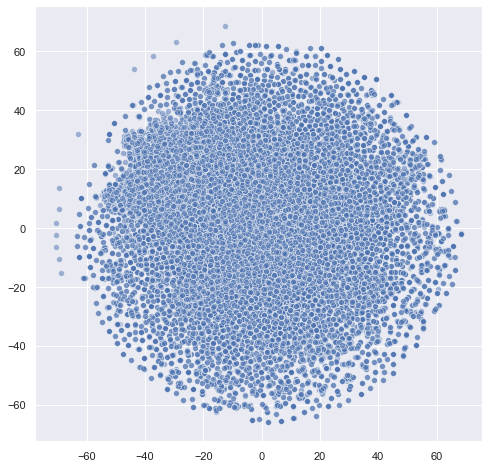

In [65]:
fix, ax = plt.subplots(figsize = (8, 8))
sbn.scatterplot(tsnedf[:, 0], tsnedf[:, 1], alpha=0.50)

In [66]:
texts = []
wordstoplot = list(np.arange(0, 100, 10))

In [67]:
for word in wordstoplot:
    texts.append(plt.text(tsnedf[word, 0], tsnedf[word, 1], pd.DataFrame(tsnedf).index[word], fontsize = 14))